In [3]:
%matplotlib inline

import numpy as np
import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageFont, ImageDraw, ImageEnhance
from matplotlib.patches import Circle

import glob
import os
from readimage import image_read
from coord_io import read_star_file

In [4]:
image = image_read("/data/zhangchi/cryodata/empiar10590/micrographs/WTcomplex_GraFix_0015_DW.mrc")
# print(image)
img_h, img_w = image.shape
print(image.shape)

/data/zhangchi/cryodata/empiar10590/micrographs/WTcomplex_GraFix_0015_DW.mrc
(3838, 3710)


/home/zhangchi/anaconda3/envs/deformable_detr/lib/python3.7/site-packages/mrcfile/mrcinterpreter.py:209: RuntimeWarning: Map ID string not found - not an MRC file, or file is corrupt
  warnings.warn(msg, RuntimeWarning)
/home/zhangchi/anaconda3/envs/deformable_detr/lib/python3.7/site-packages/mrcfile/mrcinterpreter.py:219: RuntimeWarning: Unrecognised machine stamp: 0x00 0x00 0x00 0x00
  warnings.warn(str(err), RuntimeWarning)


In [5]:
%%bash
ls /data/zhangchi/transpicker_outputs/my_outputs_10590_100_denoised/step_star_compare

WTcomplex_GraFix_0015_DW.png
WTcomplex_GraFix_0015_DW.star
WTcomplex_GraFix_0015_DW_transpicker_nms.star
WTcomplex_GraFix_0015_DW_transpicker.star
WTcomplex_GraFix_0018_DW.png
WTcomplex_GraFix_0018_DW.star
WTcomplex_GraFix_0018_DW_transpicker_nms.star
WTcomplex_GraFix_0018_DW_transpicker.star
WTcomplex_GraFix_0041_DW.png
WTcomplex_GraFix_0041_DW.star
WTcomplex_GraFix_0041_DW_transpicker_nms.star
WTcomplex_GraFix_0041_DW_transpicker.star
WTcomplex_GraFix_0042_DW.png
WTcomplex_GraFix_0042_DW.star
WTcomplex_GraFix_0042_DW_transpicker_nms.star
WTcomplex_GraFix_0042_DW_transpicker.star
WTcomplex_GraFix_0045_DW.png
WTcomplex_GraFix_0045_DW.star
WTcomplex_GraFix_0045_DW_transpicker_nms.star
WTcomplex_GraFix_0045_DW_transpicker.star
WTcomplex_GraFix_0050_DW.png
WTcomplex_GraFix_0050_DW.star
WTcomplex_GraFix_0050_DW_transpicker_nms.star
WTcomplex_GraFix_0050_DW_transpicker.star
WTcomplex_GraFix_0057_DW.png
WTcomplex_GraFix_0057_DW.star
WTcomplex_GraFix_0057_DW_transpicker_nms.star
WTcomplex_Gra

In [6]:
%%bash
ls /data/zhangchi/transpicker_outputs/my_outputs_10406_denoised/step_star_compare

FoilHole_3164986_Data_3165659_3165660_20190104_1200-60865.png
FoilHole_3164986_Data_3165659_3165660_20190104_1200-60865.star
FoilHole_3164986_Data_3165659_3165660_20190104_1200-60865_transpicker_nms.star
FoilHole_3164986_Data_3165659_3165660_20190104_1200-60865_transpicker.star
FoilHole_3165008_Data_3165659_3165660_20190104_1304-60931.png
FoilHole_3165008_Data_3165659_3165660_20190104_1304-60931.star
FoilHole_3165008_Data_3165659_3165660_20190104_1304-60931_transpicker_nms.star
FoilHole_3165008_Data_3165659_3165660_20190104_1304-60931_transpicker.star
FoilHole_3165011_Data_3165659_3165660_20190104_1313-60940.png
FoilHole_3165011_Data_3165659_3165660_20190104_1313-60940.star
FoilHole_3165011_Data_3165659_3165660_20190104_1313-60940_transpicker_nms.star
FoilHole_3165011_Data_3165659_3165660_20190104_1313-60940_transpicker.star
FoilHole_3165012_Data_3165536_3165537_20190104_1315-60941.png
FoilHole_3165012_Data_3165536_3165537_20190104_1315-60941.star
FoilHole_3165012_Data_3165536_3165537_

7
cycler('color', ['#E24A33', '#348ABD', '#988ED5', '#777777', '#FBC15E', '#8EBA42', '#FFB5B8'])
/data/zhangchi/cryodata/empiar10406/micrographs/FoilHole_3180725_Data_3165659_3165660_20190107_0937-63519.mrc


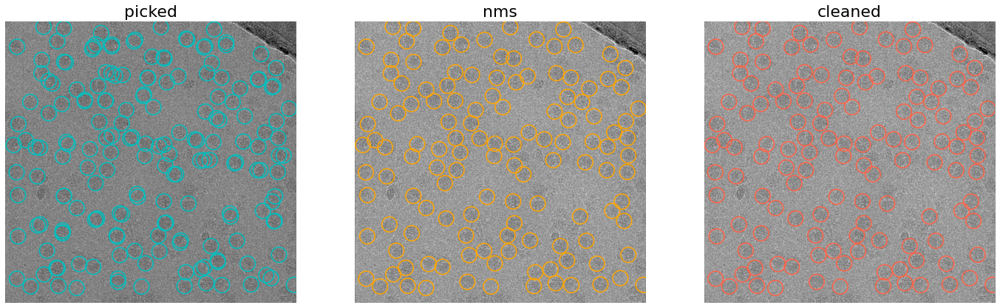

In [7]:
%matplotlib inline
plt.style.use('ggplot')

name = "FoilHole_3180725_Data_3165659_3165660_20190107_0937-63519"
img_path = f"/data/zhangchi/cryodata/empiar10406/micrographs/{name}.mrc"
root_path = '/data/zhangchi/transpicker_outputs/my_outputs_10406_denoised/step_star_compare/'
path_pick = root_path + f'{name}_transpicker.star'
path_nms = root_path + f'{name}_transpicker_nms.star'
path_clean = root_path + f'{name}.star'
boxsize=200
boxes_pick = read_star_file(path_pick, boxsize)
boxes_nms = read_star_file(path_nms, boxsize)
boxes_clean = read_star_file(path_clean, boxsize)

# display
_,ax = plt.subplots(1,3,figsize=(24,16))
ncolors = len(plt.rcParams['axes.prop_cycle'])
print(ncolors)
print(plt.rcParams['axes.prop_cycle'])


source_img = np.array(image_read(img_path), copy=False)
source_img = np.flip(source_img, 0)
mean = np.mean(source_img)
sd = np.std(source_img)
image_norm = (source_img - mean) / sd
im_h, im_w = image_norm.shape
# print(image_norm)
radius=100

ax[0].imshow(image_norm, origin="lower", cmap='gray', vmin=-3, vmax=3, interpolation='bilinear')
ax[0].set_title("picked", fontsize=22)
ax[0].axis('off')
for box in boxes_pick:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color='c')
    ax[0].add_patch(c)

ax[1].imshow(image_norm, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
ax[1].set_title("nms", fontsize=22)
ax[1].axis('off')
# ax[1].set_xticks([])
# ax[1].tick_params(axis=u'both', which=u'both',length=0)
for box in boxes_nms:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color="orange")
    ax[1].add_patch(c)

ax[2].imshow(image_norm, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
ax[2].set_title("cleaned", fontsize=22)
ax[2].axis('off')
for box in boxes_clean:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color='tomato')
    ax[2].add_patch(c)

# ['#2B1818', '#304158', '#914728', '#497EA9', '#DC8B2E', '#76CAED', '#D5CCA3']

In [8]:
print(plt.style.available)

['Solarize_Light2', '_classic_test_patch', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn', 'seaborn-bright', 'seaborn-colorblind', 'seaborn-dark', 'seaborn-dark-palette', 'seaborn-darkgrid', 'seaborn-deep', 'seaborn-muted', 'seaborn-notebook', 'seaborn-paper', 'seaborn-pastel', 'seaborn-poster', 'seaborn-talk', 'seaborn-ticks', 'seaborn-white', 'seaborn-whitegrid', 'tableau-colorblind10']


7
cycler('color', ['#E24A33', '#348ABD', '#988ED5', '#777777', '#FBC15E', '#8EBA42', '#FFB5B8'])
/data/zhangchi/cryodata/empiar10406/micrographs/FoilHole_3180717_Data_3165536_3165537_20190107_0912-63502.mrc
/data/zhangchi/cryodata/empiar10406/val/mask/FoilHole_3180717_Data_3165536_3165537_20190107_0912-63502_mask.mrc


findfont: Font family ['Times New Roman'] not found. Falling back to DejaVu Sans.


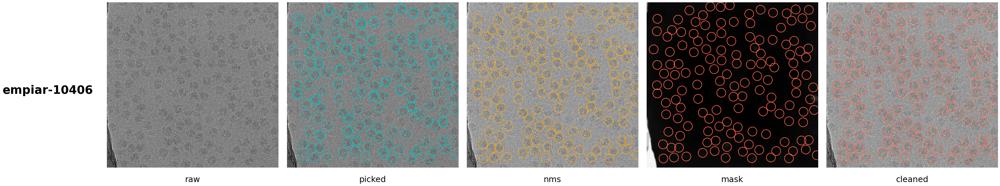

In [9]:
%matplotlib inline
from pylab import *

plt.style.use('ggplot')

name = "FoilHole_3165012_Data_3165536_3165537_20190104_1315-60941"
name = "FoilHole_3180702_Data_3165619_3165620_20190107_0822-63464"
name = "FoilHole_3180717_Data_3165659_3165660_20190107_0914-63504"
name = "FoilHole_3180717_Data_3165536_3165537_20190107_0912-63502"
img_path = f"/data/zhangchi/cryodata/empiar10406/micrographs/{name}.mrc"
root_path = '/data/zhangchi/transpicker_outputs/my_outputs_10406_denoised/step_star_compare/'
path_pick = root_path + f'{name}_transpicker.star'
path_nms = root_path + f'{name}_transpicker_nms.star'
path_clean = root_path + f'{name}.star'
boxsize=200
boxes_pick = read_star_file(path_pick, boxsize)
boxes_nms = read_star_file(path_nms, boxsize)
boxes_clean = read_star_file(path_clean, boxsize)

# display
f,ax = plt.subplots(1,5,figsize=(50,10))
plt.subplots_adjust(left=0.15,bottom=0.1,top=0.9,right=0.9,hspace=0.05, wspace=0.05)
# f.tight_layout()
f.suptitle(f"empiar-10406", x=0.1, y=0.5, fontsize=35, fontname="Times New Roman",fontweight="bold")
ncolors = len(plt.rcParams['axes.prop_cycle'])
print(ncolors)
print(plt.rcParams['axes.prop_cycle'])


source_img = np.array(image_read(img_path), copy=False)
source_img = np.flip(source_img, 0)
mean = np.mean(source_img)
sd = np.std(source_img)
image_norm = (source_img - mean) / sd
im_h, im_w = image_norm.shape
# print(image_norm)
radius=100

ax[0].imshow(image_norm, origin="lower", cmap='gray', vmin=-3, vmax=3, interpolation='bilinear')
ax[0].set_title("raw",y=-0.1, fontsize=25)
ax[0].axis('off')


ax[1].imshow(image_norm, origin="lower", cmap='gray', vmin=-3, vmax=3, interpolation='bilinear')
ax[1].set_title("picked",y=-0.1, fontsize=25)
ax[1].axis('off')
for box in boxes_pick:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color='c')
    ax[1].add_patch(c)

ax[2].imshow(image_norm, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
ax[2].set_title("nms", y=-0.1,fontsize=25)
ax[2].axis('off')
# ax[1].set_xticks([])
# ax[1].tick_params(axis=u'both', which=u'both',length=0)
for box in boxes_nms:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color="orange")
    ax[2].add_patch(c)

mask_path = "/data/zhangchi/cryodata/empiar10406/val/mask/"+name+"_mask.mrc"
mask = np.array(image_read(mask_path), copy=False)
ax[3].imshow(mask, origin="lower", cmap='Greys_r', interpolation='bilinear')
ax[3].set_title("mask", y=-0.1,fontsize=25)
ax[3].axis('off')
for box in boxes_nms:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color='tomato')
    ax[3].add_patch(c)
for box in boxes_clean:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color='tomato')
    ax[3].add_patch(c)

ax[4].imshow(image_norm, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
ax[4].set_title("cleaned", y=-0.1,fontsize=25)
ax[4].axis('off')
for box in boxes_clean:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color='tomato')
    ax[4].add_patch(c)

plt.savefig("/data/zhangchi/cryodata/empiar10406/empiar10406_example.svg")
# ['#2B1818', '#304158', '#914728', '#497EA9', '#DC8B2E', '#76CAED', '#D5CCA3']

7
cycler('color', ['#E24A33', '#348ABD', '#988ED5', '#777777', '#FBC15E', '#8EBA42', '#FFB5B8'])
/data/zhangchi/cryodata/empiar10406/micrographs/FoilHole_3180717_Data_3165659_3165660_20190107_0914-63504.mrc
/data/zhangchi/cryodata/empiar10406/val/mask/FoilHole_3180717_Data_3165659_3165660_20190107_0914-63504_mask.mrc


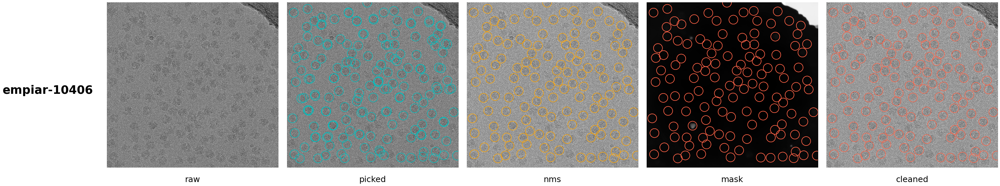

In [10]:
%matplotlib inline
from pylab import *

plt.style.use('ggplot')

name = "FoilHole_3165012_Data_3165536_3165537_20190104_1315-60941"
name = "FoilHole_3180702_Data_3165619_3165620_20190107_0822-63464"
name = "FoilHole_3180717_Data_3165659_3165660_20190107_0914-63504"
img_path = f"/data/zhangchi/cryodata/empiar10406/micrographs/{name}.mrc"
root_path = '/data/zhangchi/transpicker_outputs/my_outputs_10406_denoised/step_star_compare/'
path_pick = root_path + f'{name}_transpicker.star'
path_nms = root_path + f'{name}_transpicker_nms.star'
path_clean = root_path + f'{name}.star'
boxsize=200
boxes_pick = read_star_file(path_pick, boxsize)
boxes_nms = read_star_file(path_nms, boxsize)
boxes_clean = read_star_file(path_clean, boxsize)

# display
f,ax = plt.subplots(1,5,figsize=(50,10))
plt.subplots_adjust(left=0.15,bottom=0.1,top=0.9,right=0.9,hspace=0.05, wspace=0.05)
# f.tight_layout()
f.suptitle(f"empiar-10406", x=0.1, y=0.5, fontsize=35, fontname="Times New Roman",fontweight="bold")
ncolors = len(plt.rcParams['axes.prop_cycle'])
print(ncolors)
print(plt.rcParams['axes.prop_cycle'])


source_img = np.array(image_read(img_path), copy=False)
source_img = np.flip(source_img, 0)
mean = np.mean(source_img)
sd = np.std(source_img)
image_norm = (source_img - mean) / sd
im_h, im_w = image_norm.shape
# print(image_norm)
radius=100

ax[0].imshow(image_norm, origin="lower", cmap='gray', vmin=-3, vmax=3, interpolation='bilinear')
ax[0].set_title("raw",y=-0.1, fontsize=25)
ax[0].axis('off')


ax[1].imshow(image_norm, origin="lower", cmap='gray', vmin=-3, vmax=3, interpolation='bilinear')
ax[1].set_title("picked",y=-0.1, fontsize=25)
ax[1].axis('off')
for box in boxes_pick:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color='c')
    ax[1].add_patch(c)

ax[2].imshow(image_norm, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
ax[2].set_title("nms", y=-0.1,fontsize=25)
ax[2].axis('off')
# ax[1].set_xticks([])
# ax[1].tick_params(axis=u'both', which=u'both',length=0)
for box in boxes_nms:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color="orange")
    ax[2].add_patch(c)

mask_path = "/data/zhangchi/cryodata/empiar10406/val/mask/"+name+"_mask.mrc"
mask = np.array(image_read(mask_path), copy=False)
ax[3].imshow(mask, origin="lower", cmap='Greys_r', interpolation='bilinear')
ax[3].set_title("mask", y=-0.1,fontsize=25)
ax[3].axis('off')
for box in boxes_nms:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color='tomato')
    ax[3].add_patch(c)
for box in boxes_clean:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color='tomato')
    ax[3].add_patch(c)

ax[4].imshow(image_norm, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
ax[4].set_title("cleaned", y=-0.1,fontsize=25)
ax[4].axis('off')
for box in boxes_clean:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color='tomato')
    ax[4].add_patch(c)

plt.savefig("/data/zhangchi/cryodata/empiar10406/empiar10406_example.svg")
# ['#2B1818', '#304158', '#914728', '#497EA9', '#DC8B2E', '#76CAED', '#D5CCA3']

6
cycler('color', ['#4C72B0', '#55A868', '#C44E52', '#8172B2', '#CCB974', '#64B5CD'])
/data/zhangchi/cryodata/empiar10028/micrographs/152.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/152_mask.mrc


findfont: Font family ['Times New Roman'] not found. Falling back to DejaVu Sans.


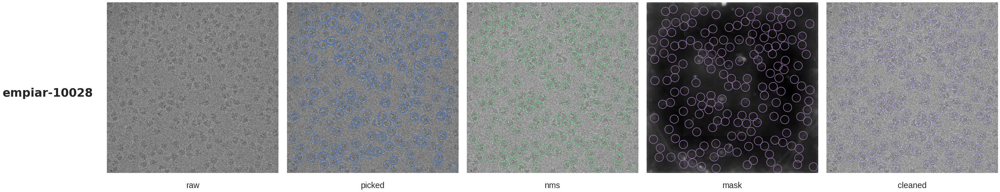

In [11]:
%matplotlib inline
from pylab import *

plt.style.use('seaborn')
colors = ['#4C72B0', '#55A868', '#C44E52', '#8172B2', '#CCB974', '#64B5CD']
name = "152"

img_path = f"/data/zhangchi/cryodata/empiar10028/micrographs/{name}.mrc"
root_path = '/data/zhangchi/transpicker_outputs/my_outputs_10028_denoised/step_star_compare/'
path_pick = root_path + f'{name}_transpicker.star'
path_nms = root_path + f'{name}_transpicker_nms.star'
path_clean = root_path + f'{name}.star'
boxsize=200
boxes_pick = read_star_file(path_pick, boxsize)
boxes_nms = read_star_file(path_nms, boxsize)
boxes_clean = read_star_file(path_clean, boxsize)

# display
f,ax = plt.subplots(1,5,figsize=(50,10))
plt.subplots_adjust(left=0.15,bottom=0.1,top=0.9,right=0.9,hspace=0.05, wspace=0.05)
# f.tight_layout()
f.suptitle(f"empiar-10028", x=0.1, y=0.5, fontsize=35, fontname="Times New Roman",fontweight="bold")
ncolors = len(plt.rcParams['axes.prop_cycle'])
print(ncolors)
print(plt.rcParams['axes.prop_cycle'])


source_img = np.array(image_read(img_path), copy=False)
source_img = np.flip(source_img, 0)
mean = np.mean(source_img)
sd = np.std(source_img)
image_norm = (source_img - mean) / sd
im_h, im_w = image_norm.shape
# print(image_norm)
radius=100

ax[0].imshow(image_norm, origin="lower", cmap='gray', vmin=-3, vmax=3, interpolation='bilinear')
ax[0].set_title("raw",y=-0.1, fontsize=25)
ax[0].axis('off')


ax[1].imshow(image_norm, origin="lower", cmap='gray', vmin=-3, vmax=3, interpolation='bilinear')
ax[1].set_title("picked",y=-0.1, fontsize=25)
ax[1].axis('off')
for box in boxes_pick:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color=colors[0])
    ax[1].add_patch(c)

ax[2].imshow(image_norm, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
ax[2].set_title("nms", y=-0.1,fontsize=25)
ax[2].axis('off')
# ax[1].set_xticks([])
# ax[1].tick_params(axis=u'both', which=u'both',length=0)
for box in boxes_nms:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color=colors[1])
    ax[2].add_patch(c)

mask_path = "/data/zhangchi/cryodata/empiar10028/val/mask/"+name+"_mask.mrc"
mask = np.array(image_read(mask_path), copy=False)
ax[3].imshow(mask, origin="lower", cmap='Greys_r', interpolation='bilinear')
ax[3].set_title("mask", y=-0.1,fontsize=25)
ax[3].axis('off')
for box in boxes_nms:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color=colors[2])
    ax[3].add_patch(c)
for box in boxes_clean:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color=colors[3])
    ax[3].add_patch(c)

ax[4].imshow(image_norm, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
ax[4].set_title("cleaned", y=-0.1,fontsize=25)
ax[4].axis('off')
for box in boxes_clean:
    c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color=colors[3])
    ax[4].add_patch(c)

plt.savefig("/data/zhangchi/cryodata/empiar10028/empiar10028_example.svg")
# ['#2B1818', '#304158', '#914728', '#497EA9', '#DC8B2E', '#76CAED', '#D5CCA3']

[(0.9948327566320646, 0.8848904267589389, 0.7319953863898501), (0.9921568627450981, 0.7660130718954248, 0.5516339869281046), (0.9874356016916571, 0.550480584390619, 0.34797385620915033), (0.9058823529411765, 0.32679738562091504, 0.22875816993464054), (0.7468050749711649, 0.059792387543252584, 0.0386159169550173)]


<Figure size 2000x1375 with 0 Axes>

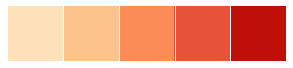

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt
plt.figure(dpi=250)
sns.set_palette("OrRd",5)
sns.palplot(sns.color_palette())
print(sns.color_palette())#返回默认颜色元组组成的list
colors = sns.color_palette()


/data/zhangchi/cryodata/empiar10028/micrographs/250.mrc
/data/zhangchi/cryodata/empiar10028/denoised/250.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/250_mask.mrc
/data/zhangchi/cryodata/empiar10028/micrographs/549.mrc
/data/zhangchi/cryodata/empiar10028/denoised/549.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/549_mask.mrc


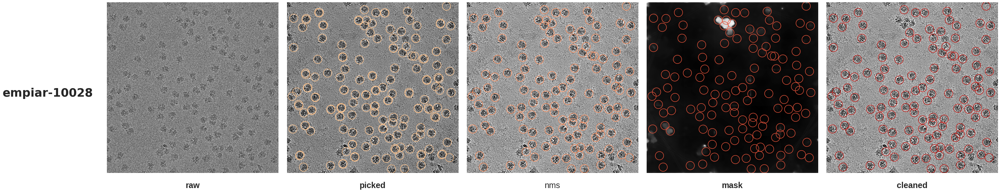

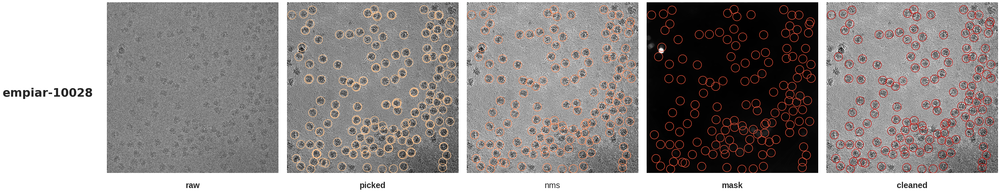

In [18]:
%matplotlib inline
from pylab import *

name='250'
def display(name):
    img_path = f"/data/zhangchi/cryodata/empiar10028/micrographs/{name}.mrc"
    denoise_path = f"/data/zhangchi/cryodata/empiar10028/denoised/{name}.mrc"
    root_path = '/data/zhangchi/transpicker_outputs/my_outputs_10028_denoised/step_star_compare_score2_nms6_clean1/'
    path_pick = root_path + f'{name}_transpicker.star'
    path_nms = root_path + f'{name}_transpicker_nms.star'
    path_clean = root_path + f'{name}.star'
    boxsize=200
    boxes_pick = read_star_file(path_pick, boxsize)
    boxes_nms = read_star_file(path_nms, boxsize)
    boxes_clean = read_star_file(path_clean, boxsize)

    # display
    f,ax = plt.subplots(1,5,figsize=(50,10))
    plt.subplots_adjust(left=0.15,bottom=0.1,top=0.9,right=0.9,hspace=0.05, wspace=0.05)
    f.suptitle(f"empiar-10028", x=0.1, y=0.5, fontsize=35, fontname="Times New Roman",fontweight="bold")
    # ncolors = len(plt.rcParams['axes.prop_cycle'])
    # print(ncolors)
    # print(plt.rcParams['axes.prop_cycle'])

    source_img = np.array(image_read(img_path), copy=False)
    source_img = np.flip(source_img, 0)
    mean = np.mean(source_img)
    sd = np.std(source_img)
    image_norm = (source_img - mean) / sd
    im_h, im_w = image_norm.shape
    radius=100

    denoised_img = np.array(image_read(denoise_path), copy=False)
    denoised_img = np.flip(denoised_img, 0)
    mean = np.mean(denoised_img)
    sd = np.std(denoised_img)
    denoised_img = (denoised_img - mean) / sd

    ax[0].imshow(image_norm, origin="lower", cmap='gray', vmin=-3, vmax=3, interpolation='bilinear')
    ax[0].set_title("raw",y=-0.1, fontsize=25,fontweight="bold")
    ax[0].axis('off')


    ax[1].imshow(denoised_img, origin="lower", cmap='gray', vmin=-3, vmax=3, interpolation='bilinear')
    ax[1].set_title("picked",y=-0.1, fontsize=25,fontweight="bold")
    ax[1].axis('off')
    for box in boxes_pick:
        c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color=colors[1])
        ax[1].add_patch(c)

    ax[2].imshow(denoised_img, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
    ax[2].set_title("nms", y=-0.1,fontsize=25)
    ax[2].axis('off')
    # ax[1].set_xticks([])
    # ax[1].tick_params(axis=u'both', which=u'both',length=0)
    for box in boxes_nms:
        c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5, color=colors[2])
        ax[2].add_patch(c)

    mask_path = "/data/zhangchi/cryodata/empiar10028/val/mask/"+name+"_mask.mrc"
    mask = np.array(image_read(mask_path), copy=False)
    ax[3].imshow(mask, origin="lower", cmap='Greys_r', interpolation='bilinear')
    ax[3].set_title("mask", y=-0.1,fontsize=25,fontweight="bold")
    ax[3].axis('off')
    for box in boxes_nms:
        c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color=colors[3])
        ax[3].add_patch(c)

    ax[4].imshow(denoised_img, origin="lower", cmap='Greys_r', vmin=-3, vmax=3, interpolation='bilinear')
    ax[4].set_title("cleaned", y=-0.1,fontsize=25,fontweight="bold")
    ax[4].axis('off')
    for box in boxes_clean:
        c = Circle((box.x+boxsize/2, box.y+boxsize/2),radius,fill=False,linewidth=1.5,color=colors[4])
        ax[4].add_patch(c)

    # plt.savefig("/data/zhangchi/cryodata/empiar10028/empiar10028_example.svg")

display('250')
display('549')

/data/zhangchi/cryodata/empiar10028/micrographs/419.mrc
/data/zhangchi/cryodata/empiar10028/denoised/419.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/419_mask.mrc
/data/zhangchi/cryodata/empiar10028/micrographs/579.mrc
/data/zhangchi/cryodata/empiar10028/denoised/579.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/579_mask.mrc
/data/zhangchi/cryodata/empiar10028/micrographs/597.mrc
/data/zhangchi/cryodata/empiar10028/denoised/597.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/597_mask.mrc
/data/zhangchi/cryodata/empiar10028/micrographs/596.mrc
/data/zhangchi/cryodata/empiar10028/denoised/596.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/596_mask.mrc
/data/zhangchi/cryodata/empiar10028/micrographs/300.mrc
/data/zhangchi/cryodata/empiar10028/denoised/300.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/300_mask.mrc


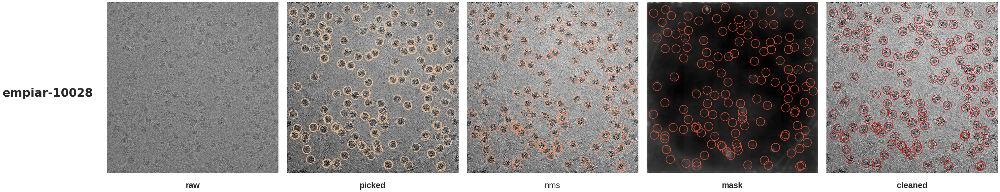

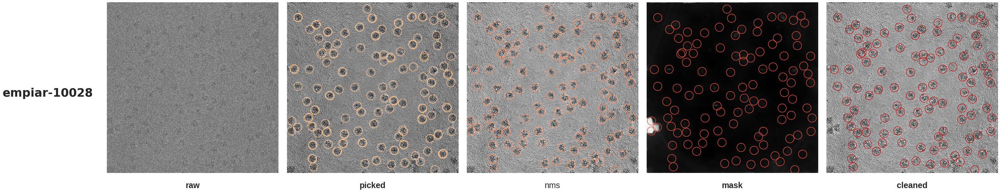

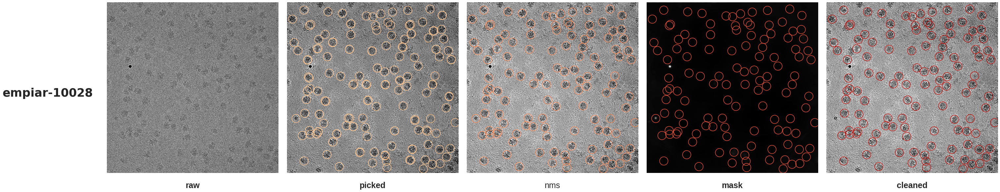

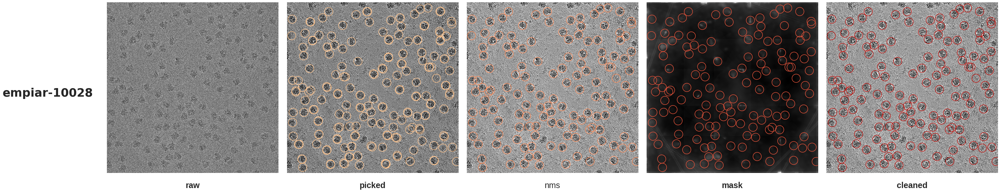

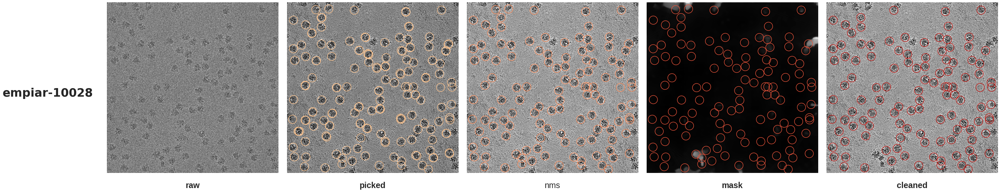

In [19]:
display('419')
display('579')
display('597')

/data/zhangchi/cryodata/empiar10028/micrographs/181.mrc
/data/zhangchi/cryodata/empiar10028/denoised/181.mrc


/home/zhangchi/anaconda3/envs/deformable_detr/lib/python3.7/site-packages/mrcfile/mrcinterpreter.py:209: RuntimeWarning: Map ID string not found - not an MRC file, or file is corrupt
  warnings.warn(msg, RuntimeWarning)
/home/zhangchi/anaconda3/envs/deformable_detr/lib/python3.7/site-packages/mrcfile/mrcinterpreter.py:219: RuntimeWarning: Unrecognised machine stamp: 0x00 0x00 0x00 0x00
  warnings.warn(str(err), RuntimeWarning)


/data/zhangchi/cryodata/empiar10028/val/mask/181_mask.mrc
/data/zhangchi/cryodata/empiar10028/micrographs/180.mrc
/data/zhangchi/cryodata/empiar10028/denoised/180.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/180_mask.mrc
/data/zhangchi/cryodata/empiar10028/micrographs/593.mrc
/data/zhangchi/cryodata/empiar10028/denoised/593.mrc
/data/zhangchi/cryodata/empiar10028/val/mask/593_mask.mrc


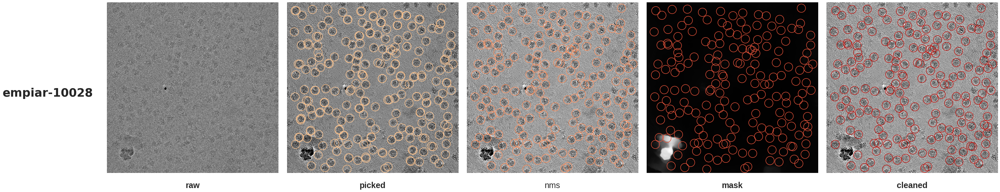

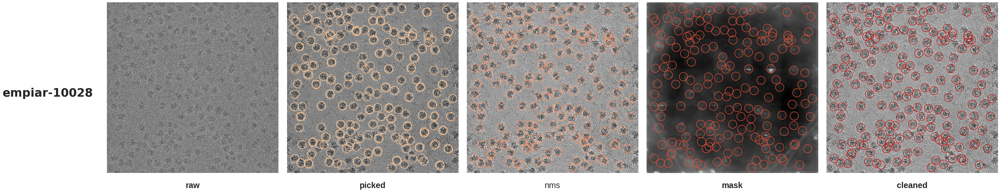

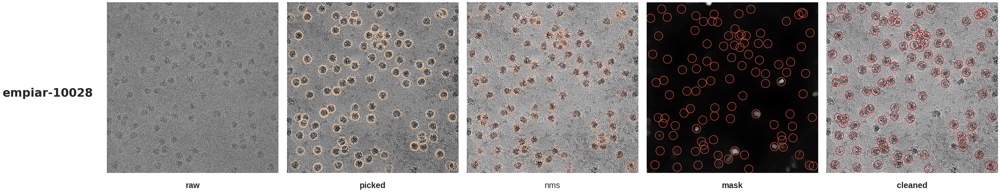

In [20]:
display('181')
display('180')
display('593')